# Powerlines extraction from PointCNN

This notebook provides a workflow of extracting powerline points from airborne LiDAR data using PointCNN model. DALES dataset provided by Varney et al. (2020) (see https://arxiv.org/abs/2004.11985) is used for model training. The model is saved and later used for prediction on AHN3 dataset(the third Dutch national airborne laser scanning flight campaign). 

## Imports
Import arcgis.learn module

In [1]:
from arcgis.learn import export_point_dataset, prepare_data, PointCNN

## Importing the training data from DALES files
In this step, `.las` files are converted to 'HDF5 binary data format'. The function `export_point_dataset()` is used for this.

In [2]:

path = r'E:\DALES_training\dales_las'
output_path = r'E:\DALES_training\results'

In [4]:
export_point_dataset(path, output_path, 
                     block_size=50.0, 
                     max_points=8192, 
                     #extra_features=[('intensity', 5000, 0)]
                    )


Export finished.


## Preparing the data

Eight classification categories are labelled: ground (1), vegetation (2), cars (3), trucks (4), powerlines (5), fences (6), poles (7) and buildings (8). Note that class 0 contains the points that are marked as unclassified which not belong to abovementioned 8 categories.

In [3]:
colormap = {'0':[220,220,220], '1':[255,0,0], '2':[0,255,0], '3':[0,0,255], '4':[51,204,204], '5':[204,102,255],
            '6':[255,255,102], '7':[255,102,0], '8':[204,0,153]}

In [4]:
data = prepare_data(output_path, dataset_type='PointCloud', batch_size=2
                   , color_mapping=colormap
                   )

In [5]:
data.classes

[0, 1, 2, 3, 4, 5, 6, 7, 8]

## Visualization of prepared data

In [8]:
data.show_batch(rows=3, color_mapping=colormap, #mask_class=[1,2], 
                max_display_point=20000)

## Instantiating PointCNN Model
First, the PointCNN model object is created, utilizing the prepared data

In [34]:
pc = PointCNN(data)

## Finding optimal starting learning rate
Next, `lr_find()` function is used to find the optimal learning rate. It controls the rate at which existing information will be overwritten by newly acquired information throughout the training process. If no value is specified, the optimal learning rate will be extracted from the learning curve during the training process.

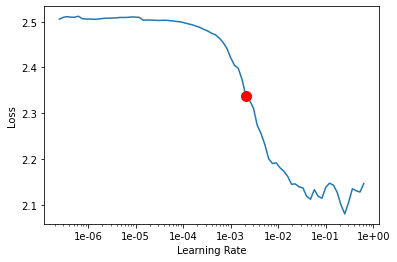

0.0020892961308540407

In [35]:
pc.lr_find()

## Training the model
`fit()` is used to train the model, where a new 'optimum learning rate' is automatically computed or the previously computed optimum learning rate can be passed.

In [36]:
pc.fit(epochs=20, tensorboard=True, early_stopping=True)

Monitor training on Tensorboard using the following command: 'tensorboard --host=lta202429 --logdir="E:\DALES_training_new\results\training_log"'


epoch,train_loss,valid_loss,accuracy,precision,recall,f1,time
0,0.456645,0.409794,0.862641,0.443946,0.391354,0.383995,14:09:49
1,0.372805,0.261352,0.916080,0.538533,0.440559,0.443072,14:23:56
2,0.314178,0.284259,0.911454,0.575630,0.443354,0.447133,14:16:48
3,0.297636,0.279788,0.918190,0.613690,0.476783,0.487046,14:21:56
4,0.309704,0.782753,0.913837,0.627573,0.451451,0.463278,14:25:10
5,0.308853,0.563249,0.872767,0.600292,0.432216,0.434789,14:15:44
6,0.292709,3.483235,0.909938,0.603320,0.460749,0.466436,13:58:36


Epoch 7: early stopping


If the number of iteration per epoch is set (e.g. 1000), then the training time will be signigicantly shorted. However, the accuracy of the training model probably will be decreased. See below as an example.

In [11]:
pc.fit(epochs=20, tensorboard=True, early_stopping=True, iters_per_epoch=1000)

Monitor training on Tensorboard using the following command: 'tensorboard --host=lta202429 --logdir="E:\DALES_training_new\results\training_log"'


epoch,train_loss,valid_loss,accuracy,precision,recall,f1,time
0,1.723178,1.422750,0.662555,0.182975,0.181561,0.159728,3:00:36
1,1.490460,1.293581,0.690597,0.246720,0.217021,0.190458,3:01:04
2,1.391362,1.209241,0.693192,0.262148,0.222981,0.196249,3:32:33
3,1.286954,1.101623,0.717030,0.290570,0.244313,0.215972,2:48:49
4,1.228196,1.079032,0.724319,0.300256,0.260918,0.237978,2:50:48
5,1.143289,0.959892,0.738794,0.312936,0.269787,0.246237,2:48:59
6,1.080773,0.901094,0.746419,0.319793,0.286965,0.264751,4:56:47
7,1.033113,0.886408,0.750107,0.319998,0.292493,0.274089,4:35:51
8,0.997192,0.827553,0.763310,0.322787,0.292320,0.276321,3:26:19
9,0.926327,0.782316,0.764829,0.331634,0.296065,0.280189,3:14:58


###### Monitor training on Tensorboard using the following cmmand: 'tensorboard --host=DELDEVAL039 --logdir="C:\"'
tensorboard --logdir=../models/<seg/cls> <--port=6006>

## Visualization of results
`show_results()` is used to visualized the results of the model, for the same scene with the ground truth. `compute_precision_recall()` can be used to generate per-class performance metrics, which is calculated based on the validation dataset.

In [21]:
pc.show_results(row=1, color_mapping=colormap, 
                #mask_class=[1,2], 
                max_display_point=10000)

## Saving the trained model

The statistic of trained model. We specifically focus on powerline extraction, which is class 5, obtaining the F1 score of 0.88.

In [38]:
pc.compute_precision_recall()

,0,1,2,3,4,5,6,7,8
precision,0.551275,0.945658,0.889316,0.691382,0.037500,0.895305,0.878282,0.686119,0.909215
recall,0.008144,0.977992,0.936867,0.053874,0.000013,0.867377,0.000188,0.202812,0.882677
f1_score,0.016051,0.961553,0.912473,0.099958,0.000026,0.881119,0.000376,0.313079,0.895750


In [37]:
pc.save("PointCNN_model_new")

Computing model metrics...


WindowsPath('E:/DALES_training_new/results/models/PointCNN_model_new')

# Extracting powerlines using trained PointCNN model
### Features available during prediction:



Selective classification: for flexibility and control in trained model's predections.

Re-mapping classes:for ease in interoperability, in terms of classcodes.

Preserve classes: updating old datasets & noise controal.

## Running the PointCNN model on unclassified point cloud for larger scale detection

In [ ]:
pc.predict_las(r'D:\UVA\LiDAR_Data\Powerline\test', r'D:\UVA\LiDAR_Data\Powerline\results')

In [96]:
pred_path = r'E:\Powerline\New10\Hybrid\hybrid_las\Area' # path to the folder containing the las files to predict on
result_path = r'E:\Powerline\New10\Hybrid\Hybrid_results'  # path to save the results


model_input_path = r'E:\DALES_training_new\results\models\PointCNN_model_new\PointCNN_model_new.pth' #path to the pretrained model; ignore this line if the model was initialised from the previous trainin phase

pointcnn = PointCNN(data, pretrained_path=model_input_path) # ignore this line if the model was initialised from the previous trainin phase

In [97]:
import timeit
start = timeit.default_timer()

pointcnn.predict_las(path=pred_path, output_path=result_path) # predicting and saving results

#pointcnn.predict_las(path=pred_path, output_path=result_path, selective_classify=[1,3,5,6,7,8], preserve_classes=[2])

stop = timeit.default_timer()
print('Time: ', stop - start)  

Time:  1104.5826378999627


### Example:

`pc.predict_las(r'input', r'output_pred', remap_classes={3:4,5:4}, selective_classify=[1,4,6], preserve_classes=[2])`